# Airline Passenger Satisfication.
<img src = "download.jfif" style = "width:600px;height:300px"/>

# Description:
<B> This dataset contains an airline passenger satisfaction survey. What factors are highly correlated to a satisfied (or dissatisfied) passenger? Can you predict passenger satisfaction?, these questions will be answered through whole of following
phases:
    
    1). Read & Check the row data
    2). preprocessing (handling & Clean)
    3). EDA (analysis & Visualisation)
    4). Feature Engineering (Selection & Extraction).
    5). Modeling: Tuning , Validation and Evaluation
                

# Features (Columns):

Gender: Gender of the passengers (Female, Male)

Customer Type: The customer type (Loyal customer, disloyal customer)

Age: The actual age of the passengers

Type of Travel: Purpose of the flight of the passengers (Personal Travel, Business Travel)

Class: Travel class in the plane of the passengers (Business, Eco, Eco Plus)

Flight distance: The flight distance of this journey

Inflight wifi service: Satisfaction level of the inflight wifi service (0:Not Applicable;1-5)

Departure/Arrival time convenient: Satisfaction level of Departure/Arrival time convenient

Ease of Online booking: Satisfaction level of online booking

Gate location: Satisfaction level of Gate location

Food and drink: Satisfaction level of Food and drink

Online boarding: Satisfaction level of online boarding

Seat comfort: Satisfaction level of Seat comfort

Inflight entertainment: Satisfaction level of inflight entertainment

On-board service: Satisfaction level of On-board service

Leg room service: Satisfaction level of Leg room service

Baggage handling: Satisfaction level of baggage handling

Check-in service: Satisfaction level of Check-in service

Inflight service: Satisfaction level of inflight service

Cleanliness: Satisfaction level of Cleanliness

Departure Delay in Minutes: Minutes delayed when departure

Arrival Delay in Minutes: Minutes delayed when Arrival

Satisfaction: Airline satisfaction level(Satisfaction, neutral or dissatisfaction)

Note that this data set was modified from this dataset by John D here. It has been cleaned up for the purposes of classification.



# Importing Liberaries

In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib
%matplotlib inline
from IPython.display import Markdown as md
import warnings
warnings.filterwarnings("ignore")

# Read & data Cleaning (Preprocessing)

In [3]:
#Reading Dataset Using pandas
df=pd.read_excel("satisfaction.xlsx")

In [4]:
#Show sample of data transposed 
df.head().T

,0,1,2,3,4
id,11112,110278,103199,47462,120011
satisfaction_v2,satisfied,satisfied,satisfied,satisfied,satisfied
Gender,Female,Male,Female,Female,Female
Customer Type,Loyal Customer,Loyal Customer,Loyal Customer,Loyal Customer,Loyal Customer
Age,65,47,15,60,70
Type of Travel,Personal Travel,Personal Travel,Personal Travel,Personal Travel,Personal Travel
Class,Eco,Business,Eco,Eco,Eco
Flight Distance,265,2464,2138,623,354
Seat comfort,0,0,0,0,0
Departure/Arrival time convenient,0,0,0,0,0


In [5]:
#Show Number of rows and columns in dataset
df.shape

(129880, 24)

## ProfileReport:
profiling is performs an automated Exploratory Data Analysis. It automatically generates a dataset profile report that gives valuable insights.

###### Insights Examples:
  1. dataset includes 18 Numerical columns and 6 Cagegorical.
  2. 400 Missing values need handling.
  3. Alests of highly correlated conlumns with our target satisfaction_v2.
  4. provide statistical analysis & visualization for each column individually etc....

In [5]:
from IPython.display import Markdown as md
from pandas_profiling import ProfileReport   
df_report = ProfileReport(df,title="dataframe fast report presinting")

In [6]:
df_report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

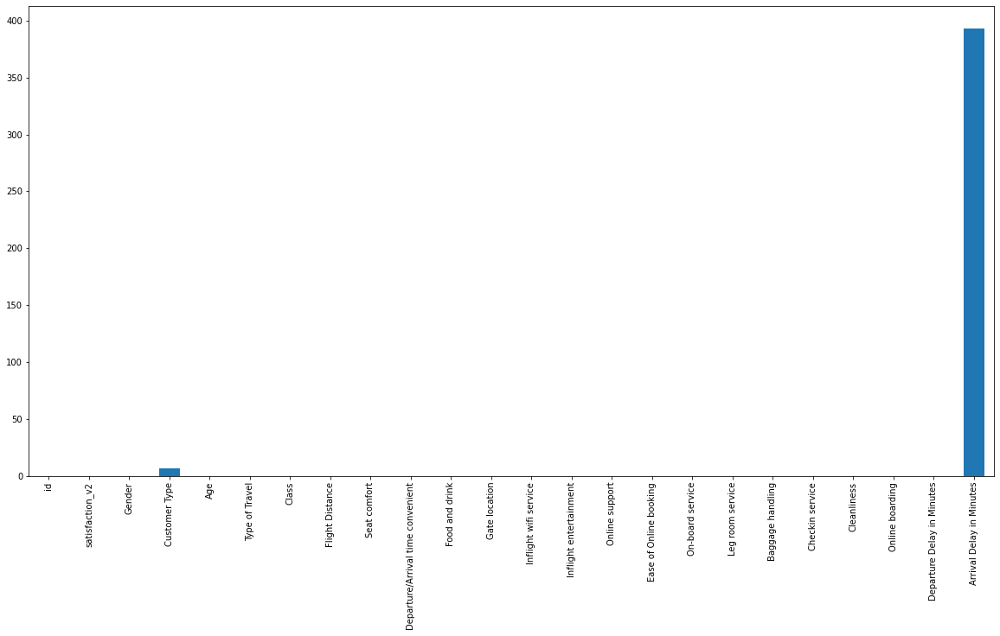

In [6]:
#To check if there any missing values in dataset
plt.figure(figsize = (20,10))
df.isna().sum(axis = 0).plot(kind = "bar")
plt.show()

In [7]:
#Drope all missing values in dataset
df.dropna(inplace = True)
#Drope Id column as it does not affect.
df.drop("id",axis = 1, inplace =True)

In [8]:
#Confirming that no needed data is dropped.
df.isna().sum()

satisfaction_v2                      0
Gender                               0
Customer Type                        0
Age                                  0
Type of Travel                       0
Class                                0
Flight Distance                      0
Seat comfort                         0
Departure/Arrival time convenient    0
Food and drink                       0
Gate location                        0
Inflight wifi service                0
Inflight entertainment               0
Online support                       0
Ease of Online booking               0
On-board service                     0
Leg room service                     0
Baggage handling                     0
Checkin service                      0
Cleanliness                          0
Online boarding                      0
Departure Delay in Minutes           0
Arrival Delay in Minutes             0
dtype: int64

# Explority Data Analysis & visualisation

In [9]:
#Show columns info.
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 129484 entries, 0 to 129879
Data columns (total 23 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   satisfaction_v2                    129484 non-null  object 
 1   Gender                             129484 non-null  object 
 2   Customer Type                      129484 non-null  object 
 3   Age                                129484 non-null  int64  
 4   Type of Travel                     129484 non-null  object 
 5   Class                              129484 non-null  object 
 6   Flight Distance                    129484 non-null  int64  
 7   Seat comfort                       129484 non-null  int64  
 8   Departure/Arrival time convenient  129484 non-null  int64  
 9   Food and drink                     129484 non-null  int64  
 10  Gate location                      129484 non-null  int64  
 11  Inflight wifi service              1294

In [10]:
#Fast Mathimatical description for all Numerical columns
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Age,129484.0,39.429049,15.117422,7.0,27.0,40.0,51.0,85.0
Flight Distance,129484.0,1981.009654,1026.895817,50.0,1359.0,1924.0,2543.0,6951.0
Seat comfort,129484.0,2.838582,1.392889,0.0,2.0,3.0,4.0,5.0
Departure/Arrival time convenient,129484.0,2.990300,1.527194,0.0,2.0,3.0,4.0,5.0
Food and drink,129484.0,2.852020,1.443604,0.0,2.0,3.0,4.0,5.0
Gate location,129484.0,2.990385,1.305930,0.0,2.0,3.0,4.0,5.0
Inflight wifi service,129484.0,3.249166,1.318774,0.0,2.0,3.0,4.0,5.0
Inflight entertainment,129484.0,3.383754,1.345974,0.0,2.0,4.0,4.0,5.0
Online support,129484.0,3.519956,1.306333,0.0,3.0,4.0,5.0,5.0
Ease of Online booking,129484.0,3.472182,1.305580,0.0,2.0,4.0,5.0,5.0


In [11]:
# To get unique values for each column individually.
for col in df:
    print(f"column name is: {col}'\n' {df[col].unique()}")

column name is: satisfaction_v2'
' ['satisfied' 'neutral or dissatisfied']
column name is: Gender'
' ['Female' 'Male']
column name is: Customer Type'
' ['Loyal Customer' 'disloyal Customer']
column name is: Age'
' [65 47 15 60 70 30 66 10 56 22 58 34 62 35 13 52 55 28  9 25 53 16 64 42
 21 20 26 48 57 31 17 33 32 38 29 24 37  7 39 11 49  8 40 45 67 59 44 69
 51 18 23 12 46 41 54 27 63 61 36 50 68 19 14 43 72 71 80 77 85 78 75 79
 74 73 76]
column name is: Type of Travel'
' ['Personal Travel' 'Business travel']
column name is: Class'
' ['Eco' 'Business' 'Eco Plus']
column name is: Flight Distance'
' [ 265 2464 2138 ... 5832 5120 4260]
column name is: Seat comfort'
' [0 1 4 5 2 3]
column name is: Departure/Arrival time convenient'
' [0 1 2 3 4 5]
column name is: Food and drink'
' [0 1 2 3 4 5]
column name is: Gate location'
' [2 3 4 1 5 0]
column name is: Inflight wifi service'
' [2 0 3 4 5 1]
column name is: Inflight entertainment'
' [4 2 0 3 5 1]
column name is: Online support'
' [2 3 

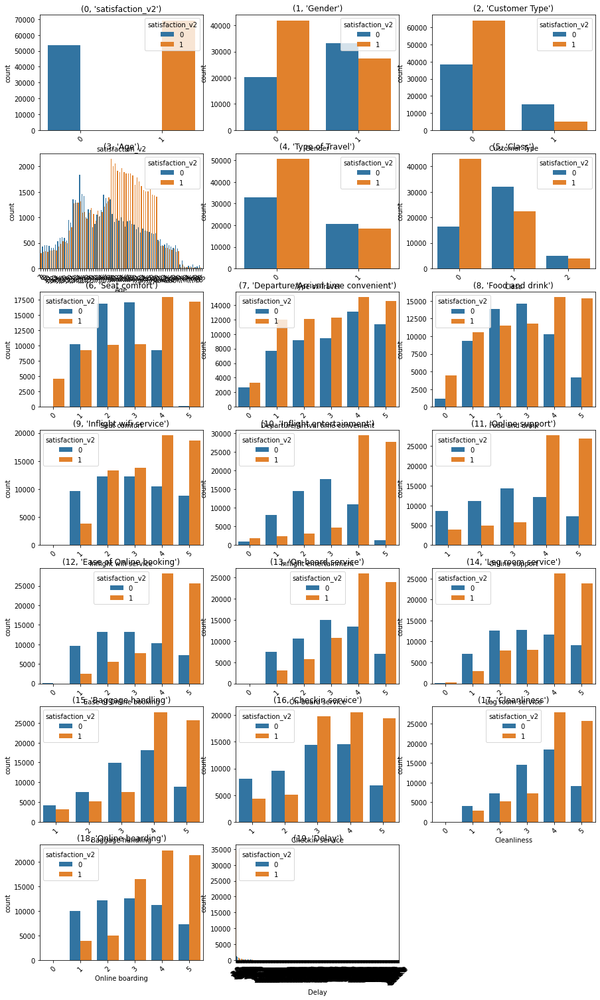

In [49]:
#Count each colum Features based on satisfaction.

#Figure Size
plt.figure(figsize=(15,30))
#Loop for each column and return column index by using enumerate.
for i in enumerate(df.columns):
    #Subploting columns.
    plt.subplot(8,3, i[0]+1)
    #Count data hue for satisfaction column. 
    sns.countplot(data= df, x=i[1], hue='satisfaction_v2')
    #Column name.
    plt.title(f"{i}")
    #Rotate x-axis featues.
    plt.xticks(rotation=45)


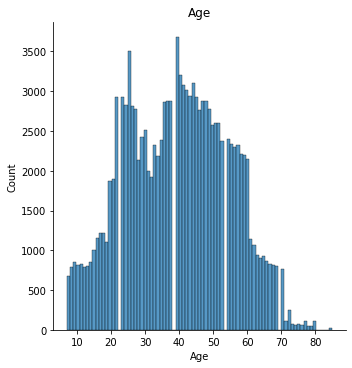

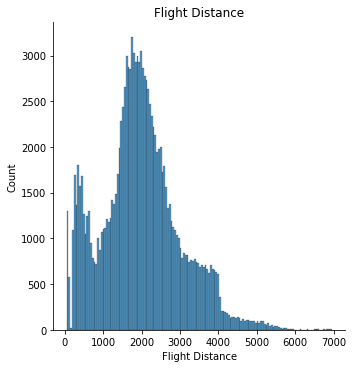

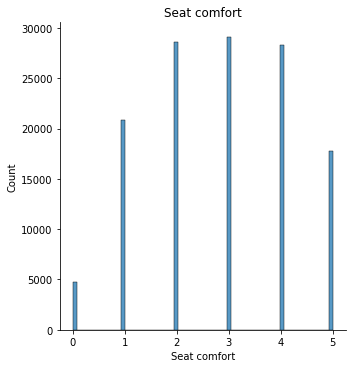

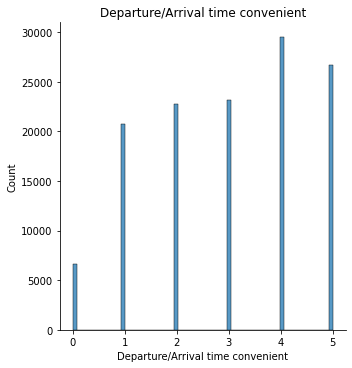

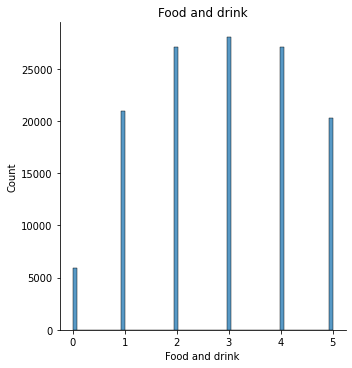

...

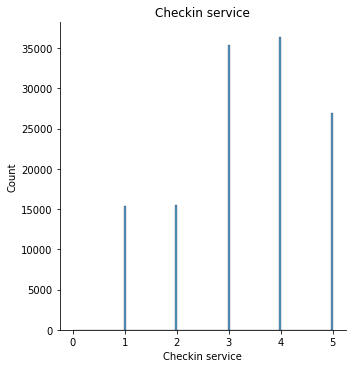

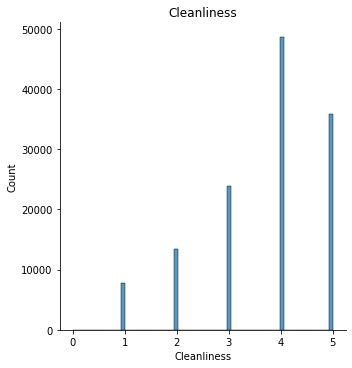

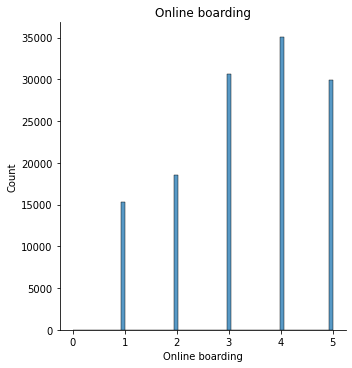

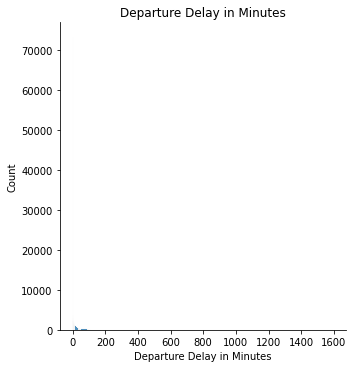

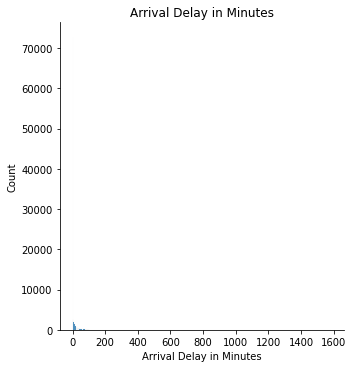

In [14]:
#Show variation of each numerical data distribution.
Numerical_df=df.drop(df.loc[:,df.dtypes==np.object],axis = 1)
for i in Numerical_df:
    sns.displot(Numerical_df[i])
    plt.title(f"{i}")
    plt.show()

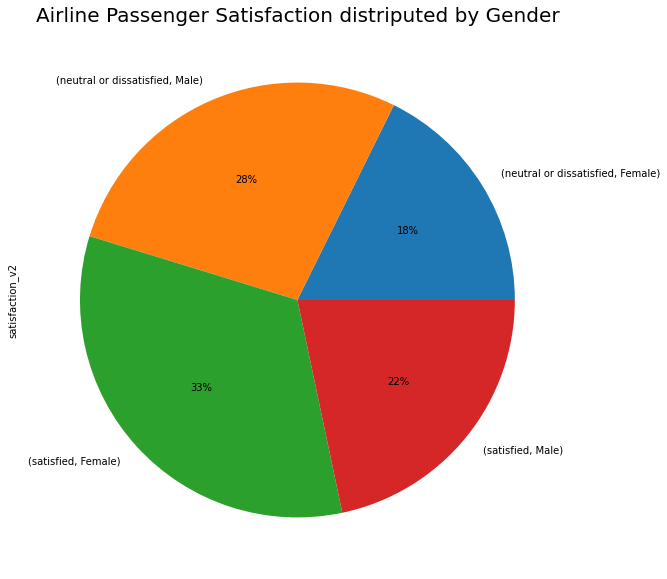

In [15]:
#Airline Passenger Satisfaction distributed by Gender.
plt.figure(figsize=(10,10))
df.groupby(by = ["satisfaction_v2","Gender"])["satisfaction_v2"].count().plot.pie(autopct="%.0f%%")
plt.title("Airline Passenger Satisfaction distriputed by Gender",fontsize = 20)
plt.show()

<AxesSubplot:>

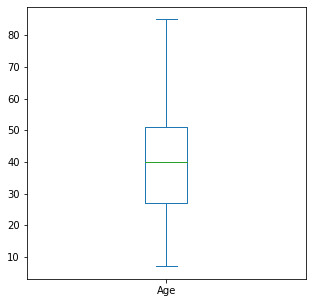

In [16]:
# Age distribution to see most ages active in truveling.
#figuring that ages between (27,53) most frequent in traveling
#Considering ages out of this Range as Quartile.
df["Age"].plot(kind = "box",figsize = (5,5))

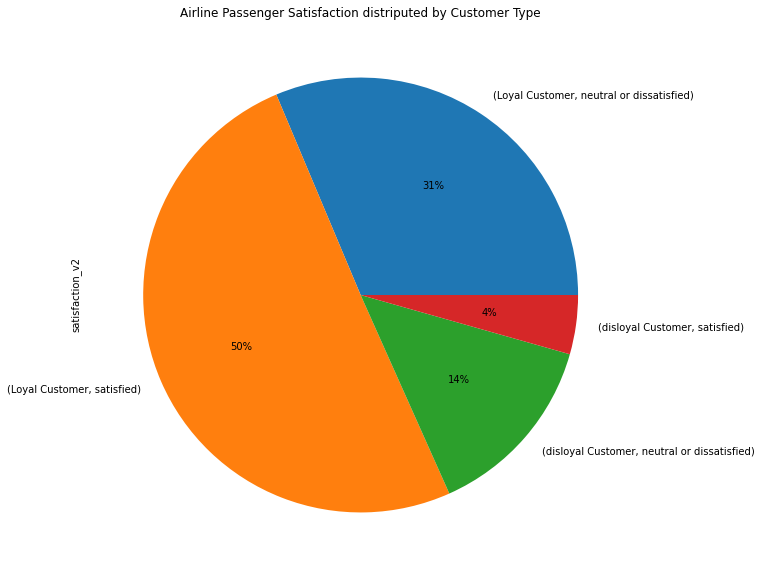

In [17]:
#Customer Type VS satisfaction
plt.figure(figsize = (10,10))
df.groupby(by = ["Customer Type","satisfaction_v2"])["satisfaction_v2"].count().plot.pie(autopct="%.0f%%")
plt.title("Airline Passenger Satisfaction distriputed by Customer Type")
plt.show()

<AxesSubplot:title={'center':'Class'}>

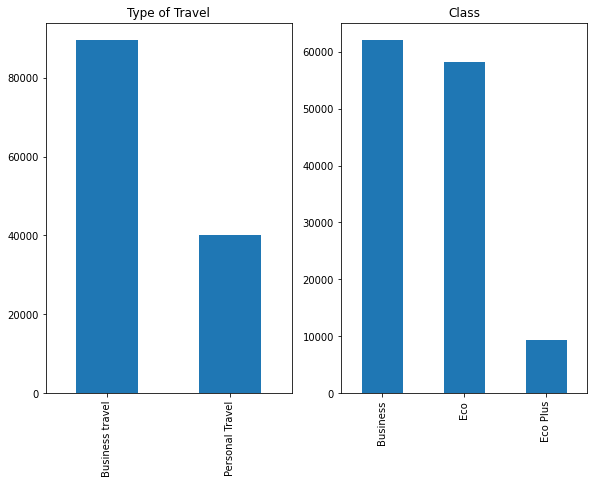

In [18]:
#Count each type of travelier.
plt.subplot(231)
df["Type of Travel"].value_counts().plot(kind = "bar", title = "Type of Travel",figsize = (15,15))
#Count each type of class variation.
plt.subplot(232)
df["Class"].value_counts().plot(kind = "bar", title = "Class")


array([[<AxesSubplot:title={'center':'Age'}>,
        <AxesSubplot:title={'center':'Flight Distance'}>,
        <AxesSubplot:title={'center':'Seat comfort'}>,
        <AxesSubplot:title={'center':'Departure/Arrival time convenient'}>],
       [<AxesSubplot:title={'center':'Food and drink'}>,
        <AxesSubplot:title={'center':'Gate location'}>,
        <AxesSubplot:title={'center':'Inflight wifi service'}>,
        <AxesSubplot:title={'center':'Inflight entertainment'}>],
       [<AxesSubplot:title={'center':'Online support'}>,
        <AxesSubplot:title={'center':'Ease of Online booking'}>,
        <AxesSubplot:title={'center':'On-board service'}>,
        <AxesSubplot:title={'center':'Leg room service'}>],
       [<AxesSubplot:title={'center':'Baggage handling'}>,
        <AxesSubplot:title={'center':'Checkin service'}>,
        <AxesSubplot:title={'center':'Cleanliness'}>,
        <AxesSubplot:title={'center':'Online boarding'}>],
       [<AxesSubplot:title={'center':'Departure De

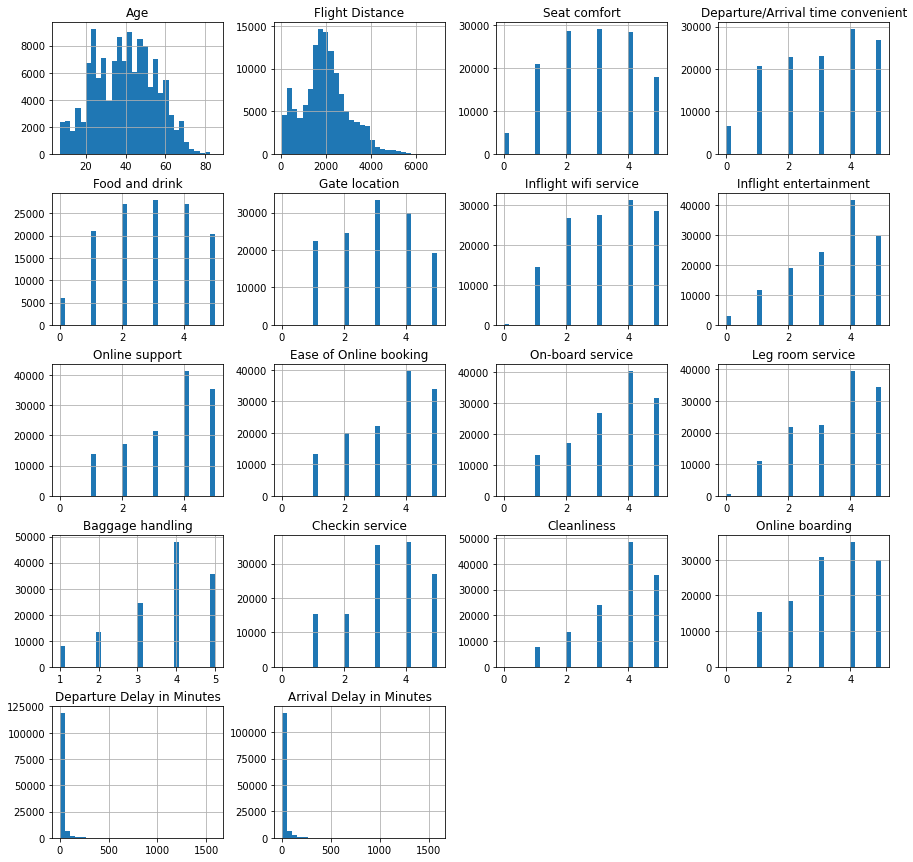

In [19]:
# Histogram to display data frequent in each column index.
df.hist(figsize = (15, 15), bins=30)

<AxesSubplot:xlabel='Flight Distance'>

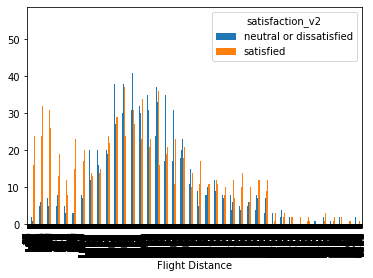

In [20]:
# How does distance affect Passenger satisfaction.
pd.crosstab(df['Flight Distance'],df['satisfaction_v2']).plot(kind = "bar")

<AxesSubplot:xlabel='Seat comfort'>

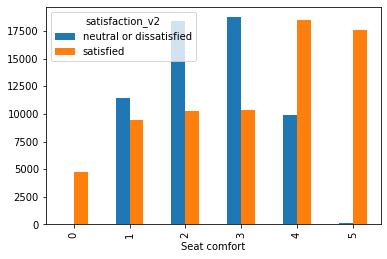

In [21]:
# Does Seat Comfort affect Passenger Satisfaction?
pd.crosstab(df['Seat comfort'],df['satisfaction_v2']).plot(kind = "bar")

<AxesSubplot:xlabel='Class'>

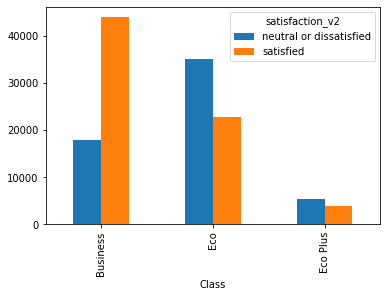

In [22]:
# Does Class type affect passenger Satisfaction?
pd.crosstab(df['Class'],df['satisfaction_v2']).plot(kind = "bar")

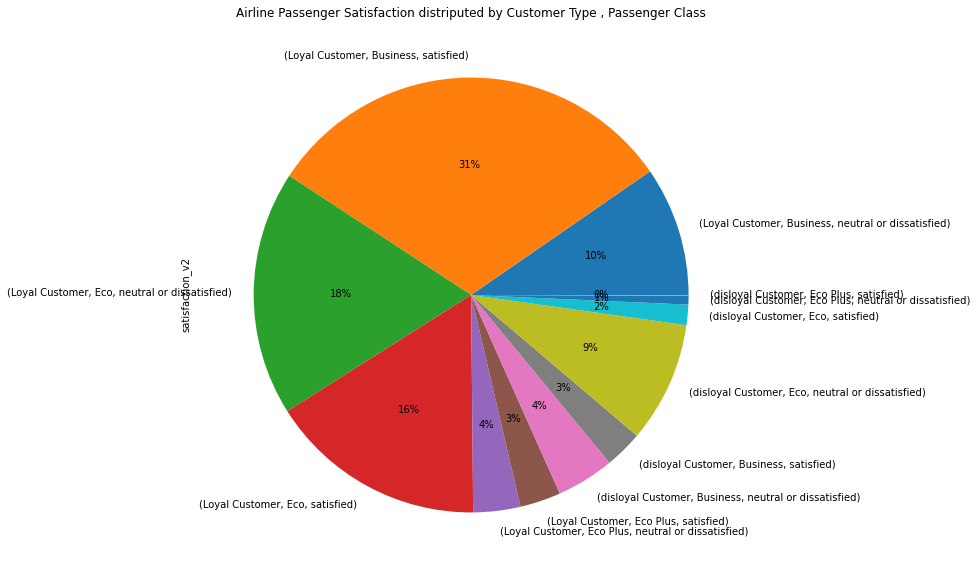

In [23]:
# Passenger Satisfaction based on Customer type and Passenger Class distribution
plt.figure(figsize = (10,10))
df.groupby(by = ["Customer Type","Class","satisfaction_v2"])["satisfaction_v2"].count().plot.pie(autopct="%.0f%%")
plt.title("Airline Passenger Satisfaction distriputed by Customer Type , Passenger Class")
plt.show()

# Feature Engineering:

In [12]:
#Split Columns into numerical and Categorical data
Categorical_df=df.loc[:,df.dtypes==np.object]
Numerical_df=df.drop(df.loc[:,df.dtypes==np.object],axis = 1)


# To get unique values for each Categorical individually.
for col in Categorical_df:
    print(f"column name is: {col}'\n' {df[col].unique()}")
    
list(Categorical_df.columns)

column name is: satisfaction_v2'
' ['satisfied' 'neutral or dissatisfied']
column name is: Gender'
' ['Female' 'Male']
column name is: Customer Type'
' ['Loyal Customer' 'disloyal Customer']
column name is: Type of Travel'
' ['Personal Travel' 'Business travel']
column name is: Class'
' ['Eco' 'Business' 'Eco Plus']


['satisfaction_v2', 'Gender', 'Customer Type', 'Type of Travel', 'Class']

In [13]:
df.head(5)

,satisfaction_v2,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Seat comfort,Departure/Arrival time convenient,Food and drink,...,Online support,Ease of Online booking,On-board service,Leg room service,Baggage handling,Checkin service,Cleanliness,Online boarding,Departure Delay in Minutes,Arrival Delay in Minutes
0,satisfied,Female,Loyal Customer,65,Personal Travel,Eco,265,0,0,0,...,2,3,3,0,3,5,3,2,0,0.0
1,satisfied,Male,Loyal Customer,47,Personal Travel,Business,2464,0,0,0,...,2,3,4,4,4,2,3,2,310,305.0
2,satisfied,Female,Loyal Customer,15,Personal Travel,Eco,2138,0,0,0,...,2,2,3,3,4,4,4,2,0,0.0
3,satisfied,Female,Loyal Customer,60,Personal Travel,Eco,623,0,0,0,...,3,1,1,0,1,4,1,3,0,0.0
4,satisfied,Female,Loyal Customer,70,Personal Travel,Eco,354,0,0,0,...,4,2,2,0,2,4,2,5,0,0.0


In [14]:
# Converting all categorincal data into numerical in same dataset.
# Importing Encoder Modules.
from sklearn.preprocessing import OneHotEncoder,LabelEncoder
# Define LabelEncoder
le = LabelEncoder()
# iterate dataset columns.
for i in range(0,df.shape[1]):
    # Iterate on categorical columns only.
    if df.dtypes[i]=='object':
        # Transformation.
        df[df.columns[i]] = le.fit_transform(df[df.columns[i]])

In [15]:
df.head(5)

,satisfaction_v2,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Seat comfort,Departure/Arrival time convenient,Food and drink,...,Online support,Ease of Online booking,On-board service,Leg room service,Baggage handling,Checkin service,Cleanliness,Online boarding,Departure Delay in Minutes,Arrival Delay in Minutes
0,1,0,0,65,1,1,265,0,0,0,...,2,3,3,0,3,5,3,2,0,0.0
1,1,1,0,47,1,0,2464,0,0,0,...,2,3,4,4,4,2,3,2,310,305.0
2,1,0,0,15,1,1,2138,0,0,0,...,2,2,3,3,4,4,4,2,0,0.0
3,1,0,0,60,1,1,623,0,0,0,...,3,1,1,0,1,4,1,3,0,0.0
4,1,0,0,70,1,1,354,0,0,0,...,4,2,2,0,2,4,2,5,0,0.0


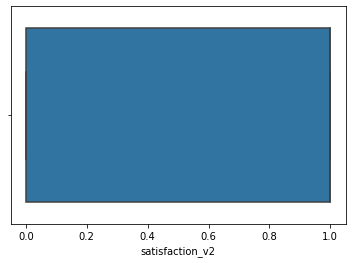

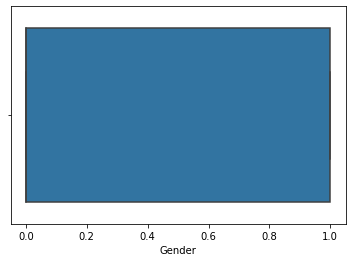

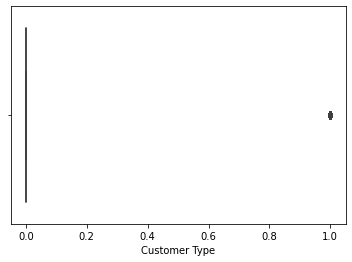

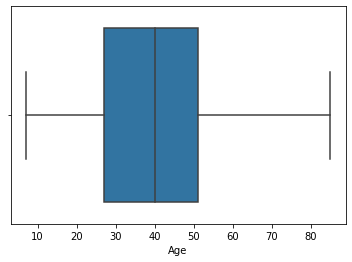

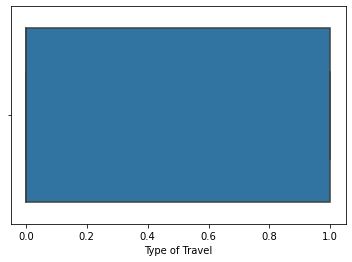

...

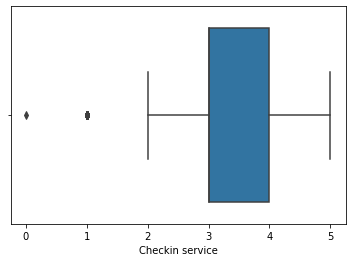

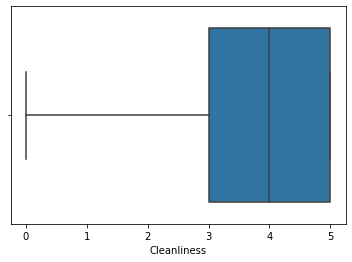

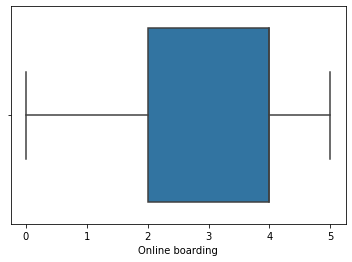

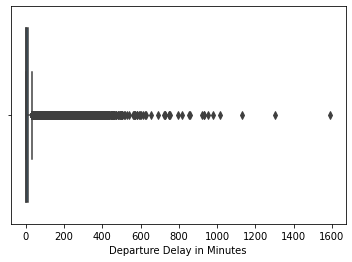

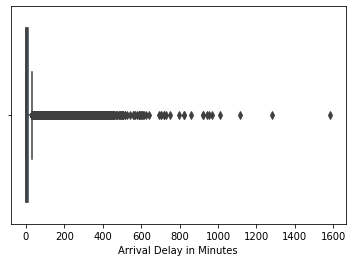

In [26]:
# Plot columns to check Outliers
for i in df:
    sns.boxplot(df[i])
    plt.show()

In [16]:
# detect outlier by using IQR.
from collections import Counter
def detect_outliers(df,features):
    # empty list to add over range indeces
    outlier_indices = []
    for data in features:
        # 1st quartile
        Q1 = np.percentile(df[data],25)
        # 3rd quartile
        Q3 = np.percentile(df[data],75)
        # IQR
        IQR = Q3 - Q1
        # Outlier step
        outlier_step = IQR * 1.5
        # detect outlier and their indeces
        outlier_list_col = df[(df[data] < Q1 - outlier_step) | (df[data] > Q3 + outlier_step)].index
        # store indeces
        outlier_indices.extend(outlier_list_col)
    
    outlier_indices = Counter(outlier_indices)
    multiple_outliers = list(i for i, v in outlier_indices.items() if v > 2)
    
    return multiple_outliers


In [17]:
# Delete outlier from original data
Features=np.array(df.columns)
df.drop(detect_outliers(df,Features),inplace = True)

In [18]:
df

,satisfaction_v2,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Seat comfort,Departure/Arrival time convenient,Food and drink,...,Online support,Ease of Online booking,On-board service,Leg room service,Baggage handling,Checkin service,Cleanliness,Online boarding,Departure Delay in Minutes,Arrival Delay in Minutes
0,1,0,0,65,1,1,265,0,0,0,...,2,3,3,0,3,5,3,2,0,0.0
1,1,1,0,47,1,0,2464,0,0,0,...,2,3,4,4,4,2,3,2,310,305.0
2,1,0,0,15,1,1,2138,0,0,0,...,2,2,3,3,4,4,4,2,0,0.0
3,1,0,0,60,1,1,623,0,0,0,...,3,1,1,0,1,4,1,3,0,0.0
4,1,0,0,70,1,1,354,0,0,0,...,4,2,2,0,2,4,2,5,0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
129869,1,0,1,55,1,1,1953,5,2,5,...,5,1,1,1,3,3,4,1,0,0.0
129871,1,0,1,35,1,1,3287,5,4,5,...,2,2,4,5,4,4,3,2,9,0.0
129872,1,0,1,69,1,1,2240,5,4,5,...,4,4,5,4,4,3,4,4,4,0.0
129874,1,0,1,11,1,1,2752,5,5,5,...,2,2,3,5,3,5,4,2,5,0.0


In [19]:
# correlation of each column related to another(influance) 
df.corr()

,satisfaction_v2,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Seat comfort,Departure/Arrival time convenient,Food and drink,...,Online support,Ease of Online booking,On-board service,Leg room service,Baggage handling,Checkin service,Cleanliness,Online boarding,Departure Delay in Minutes,Arrival Delay in Minutes
satisfaction_v2,1.000000,-0.222991,-0.276942,0.111931,-0.127153,-0.278526,-0.039598,0.233772,-0.028564,0.114102,...,0.390524,0.435278,0.343418,0.308219,0.256837,0.248895,0.253092,0.337428,-0.025104,-0.034706
Gender,-0.222991,1.000000,-0.029280,0.008596,0.006825,-0.011607,0.125375,-0.075287,0.054207,-0.062046,...,-0.095035,-0.087488,-0.061248,-0.076216,-0.019228,-0.021537,-0.017564,-0.050277,0.000668,-0.000783
Customer Type,-0.276942,-0.029280,1.000000,-0.273523,-0.293804,0.030387,0.022890,-0.037670,-0.176873,-0.041527,...,-0.185581,-0.149214,-0.064455,-0.095944,0.004307,-0.022020,0.005454,-0.106677,-0.094469,-0.092438
Age,0.111931,0.008596,-0.273523,1.000000,-0.058401,-0.117549,-0.254146,0.006376,0.031624,0.012275,...,0.121411,0.072175,0.059657,0.085729,-0.015981,0.022659,-0.020290,0.037110,0.021642,0.018504
Type of Travel,-0.127153,0.006825,-0.293804,-0.058401,1.000000,0.502871,-0.118344,0.012122,0.190093,-0.033589,...,-0.046792,-0.035929,0.024432,0.007345,0.045875,0.051909,0.054889,-0.012766,0.034902,0.034600
Class,-0.278526,-0.011607,0.030387,-0.117549,0.502871,1.000000,-0.147945,0.039016,0.061623,-0.038141,...,-0.172253,-0.125480,-0.162683,-0.128363,-0.128954,-0.130206,-0.122110,-0.095161,0.006113,0.011350
Flight Distance,-0.039598,0.125375,0.022890,-0.254146,-0.118344,-0.147945,1.000000,-0.040653,0.002242,-0.004995,...,-0.029629,-0.021695,-0.027126,-0.033447,0.020058,0.006746,0.015836,0.012060,0.055260,0.053040
Seat comfort,0.233772,-0.075287,-0.037670,0.006376,0.012122,0.039016,-0.040653,1.000000,0.440680,0.718524,...,0.114244,0.208094,0.114575,0.134301,0.112406,0.031893,0.102282,0.125270,-0.006519,-0.008644
Departure/Arrival time convenient,-0.028564,0.054207,-0.176873,0.031624,0.190093,0.061623,0.002242,0.440680,1.000000,0.529245,...,-0.004955,-0.003824,0.053972,0.026287,0.066035,0.058597,0.066665,-0.002890,0.025632,0.024214
Food and drink,0.114102,-0.062046,-0.041527,0.012275,-0.033589,-0.038141,-0.004995,0.718524,0.529245,1.000000,...,0.027613,0.040719,0.034237,0.074792,0.034488,0.005926,0.031406,0.013041,-0.007338,-0.008609


In [20]:
# Influance of each column related to our targeted coulmn.
df.corr()[["satisfaction_v2"]].sort_values("satisfaction_v2",ascending = False)

,satisfaction_v2
satisfaction_v2,1.000000
Inflight entertainment,0.520969
Ease of Online booking,0.435278
Online support,0.390524
On-board service,0.343418
Online boarding,0.337428
Leg room service,0.308219
Baggage handling,0.256837
Cleanliness,0.253092
Checkin service,0.248895


###### Feature extraction & Selection(Manual Selection.)

- Departure Delay in Minutes & Arrival Delay in Minutes higly correlated (0.965291):
      
      - Replaced and added under new feature [Delay]
   
- Gate location & Flight Distance almost no influance passenger satisfication:
    
      - Considered as no needed data 0 influance

In [21]:
# Combines arrival & departure as new feature.
df["Delay"]= df["Departure Delay in Minutes"] + df["Arrival Delay in Minutes"]

In [22]:
# Remove Departure & Arrival as united in coulumn Delay
print()
df.drop(["Departure Delay in Minutes","Arrival Delay in Minutes"
                    ,"Flight Distance","Gate location"], axis = 1 , inplace = True)

####  Splitting Data & Feature Scalling

In [23]:
# Splitting data.
Input = df.drop("satisfaction_v2",axis = 1)
Result = df["satisfaction_v2"]
print(f" the input data is: {Input}'\n\n******************\n\n'the result is: {Result} ")

 the input data is:         Gender  Customer Type  Age  Type of Travel  Class  Seat comfort  \
0            0              0   65               1      1             0   
1            1              0   47               1      0             0   
2            0              0   15               1      1             0   
3            0              0   60               1      1             0   
4            0              0   70               1      1             0   
...        ...            ...  ...             ...    ...           ...   
129869       0              1   55               1      1             5   
129871       0              1   35               1      1             5   
129872       0              1   69               1      1             5   
129874       0              1   11               1      1             5   
129875       0              1   29               1      1             5   

        Departure/Arrival time convenient  Food and drink  \
0                 

###### Standardization(Scalling):
         

In [24]:
# Import packages and modules
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

# Splitting data (test,train).
x_train,x_test,y_train,y_test = train_test_split(Input,Result,test_size = 0.2 , random_state = 42)

# Scalling
scaler = StandardScaler()

# Fitting 
scaler =scaler.fit(x_train)

# Transforming trained data
x_train_scaled = scaler.transform(x_train)

# Transforming test data
x_test_scaled = scaler.transform(x_test)

# Modeling

###### Auto_ML selection: Lazypredict

In [36]:
# Import AutoML Lazypredict.
from lazypredict.Supervised import LazyClassifier

clf = LazyClassifier(verbose=0,ignore_warnings=True, custom_metric=None)

# Fitting trained and test datasets.
models,predictions = clf.fit(x_train_scaled, x_test_scaled, y_train, y_test)

# Show modules results.
models

100%|███████████████████████████████████████████████████████████████████████████████| 29/29 [1:14:29<00:00, 154.12s/it]


,Accuracy,Balanced Accuracy,ROC AUC,F1 Score,Time Taken
Model,,,,,
ExtraTreesClassifier,0.96,0.96,0.96,0.96,93.56
RandomForestClassifier,0.96,0.96,0.96,0.96,46.54
XGBClassifier,0.95,0.95,0.95,0.95,33.30
LGBMClassifier,0.95,0.95,0.95,0.95,6.70
BaggingClassifier,0.95,0.95,0.95,0.95,27.20
SVC,0.95,0.95,0.95,0.95,681.30
DecisionTreeClassifier,0.94,0.94,0.94,0.94,7.36
KNeighborsClassifier,0.93,0.93,0.93,0.93,299.76
ExtraTreeClassifier,0.91,0.91,0.91,0.91,2.27


###### Manual Model Selection

In [25]:
#Importing models.
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from lightgbm import LGBMClassifier
from xgboost import XGBClassifier
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV
from sklearn.metrics import accuracy_score
from time import perf_counter

###### Selection without scalling data

In [38]:
# Define prediction Algorithms
lgb_clf = LGBMClassifier()
rfc_clf = RandomForestClassifier()
svm_clf = SVC(probability =True)
knn_clf = KNeighborsClassifier()
xgb_clf= XGBClassifier()



# Algorithms List
classifiers = [lgb_clf,rfc_clf,svm_clf,knn_clf,xgb_clf]
# Empty List for Accuracy results.
accuracy=[]
# Empty List for Algorithms results.
name =[]

# Empty List for timing
timetaken = []


# Looping Models
for i in classifiers:
    
    # Start time
    start_time = perf_counter()
    
    # Fitting data
    i.fit(x_train,y_train)
    
    # prediction results after data trained.
    y_pred = i.predict(x_test)
    
    # add accuracy results of each model in emptiy list.
    accuracy.append(accuracy_score(y_test,y_pred))
    
    # add algorithms name in empty list
    name.append(i.__class__.__name__)
    
    end_time = perf_counter()
    
    timetaken.append(end_time-start_time)


    
    
# saving results in dictionary     
data = {'Algorithm': name , 'Score': accuracy,"timetaken":timetaken }

# converting dic into dataframe(readable)
result = pd.DataFrame(data)


# prind dataframe results.
result

,Algorithm,Score,timetaken
0,LGBMClassifier,0.95,6.02
1,RandomForestClassifier,0.96,46.18
2,SVC,0.84,57293.08
3,KNeighborsClassifier,0.87,43.50
4,XGBClassifier,0.95,32.32


In [39]:
# Define prediction Algorithms
lgb_clf = LGBMClassifier()
rfc_clf = RandomForestClassifier()
svm_clf = SVC(probability =True)
knn_clf = KNeighborsClassifier()
xgb_clf= XGBClassifier()



# Algorithms List
classifiers = [lgb_clf,rfc_clf,svm_clf,knn_clf,xgb_clf]
# Empty List for Accuracy results.
accuracy=[]
# Empty List for Algorithms results.
name =[]

# Empty List for timing
timetaken = []


# Looping Models
for i in classifiers:
    
    # Start time
    start_time = perf_counter()
    
    # Fitting data
    i.fit(x_train_scaled,y_train)
    
    # prediction results after data trained.
    y_pred = i.predict(x_test_scaled)
    
    # add accuracy results of each model in emptiy list.
    accuracy.append(accuracy_score(y_test,y_pred))
    
    # add algorithms name in empty list
    name.append(i.__class__.__name__)
    
    end_time = perf_counter()
    
    timetaken.append(end_time-start_time)
    
    

    
    
# saving results in dictionary     
data = {'Algorithm': name , 'Score': accuracy,"timetaken":timetaken }

# converting dic into dataframe(readable)
result = pd.DataFrame(data)

# prind dataframe results.
result

,Algorithm,Score,timetaken
0,LGBMClassifier,0.95,6.45
1,RandomForestClassifier,0.96,45.29
2,SVC,0.95,5763.42
3,KNeighborsClassifier,0.93,353.81
4,XGBClassifier,0.95,62.02


###### Model selection results: From Auto_Ml and manual model selection we can see that RabdomForestClassifier Algorithm has best Score and by comparing time taken with other algorithms is considered as lowest after LGBMClassifier, Also Scalling does not affect algorithms that depends on decision tree methods,affected models is (SVC,KNeighborsClassifier) but still RandomForestClassifier is the best model for use

###### HyperParameter Tuning :
process of selecting optimal parameters values for selected learning algorithm to apply on any dataset
and this process is important because,It can give optimized values for hyperparameters,
which maximizes models predictive accuracy.

In [52]:
# Import packages & Modules.
from time import perf_counter
from sklearn.model_selection import GridSearchCV , cross_val_score ,cross_validate
from sklearn.ensemble import RandomForestClassifier


# Save parameters for tuning.
params_rfc = { "n_estimators":[30,50,100,200],
               "max_depth":[6,31,50,100],
               "criterion":["gini","entropy"] 
              } 


# select optimal parameter values using GraidSearch technique.
gs = GridSearchCV(RandomForestClassifier(),param_grid=params_rfc,verbose=1, n_jobs = -1)

In [53]:
# Start time
start_time = perf_counter()

# fitting trained data.
gs.fit(x_train , y_train)

# end time. 
end_time = perf_counter()

Fitting 5 folds for each of 32 candidates, totalling 160 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed: 10.5min
[Parallel(n_jobs=-1)]: Done 160 out of 160 | elapsed: 47.7min finished


In [56]:
#Show best accuracy score after tuning.  
print("best score:", gs.best_score_)
#Show best parameters selected.
print("best parameters:", gs.best_params_)
#Show total time taken.
print("Grid search time is: %f Seconds" % (end_time-start_time))

best score: 0.9573492623364637
best parameters: {'criterion': 'entropy', 'max_depth': 50, 'n_estimators': 200}
Grid search time is: 3050.803098 Seconds


In [26]:
# Import module.
from sklearn.ensemble import RandomForestClassifier

# saving algoritm in clf var. 
clf = RandomForestClassifier()

# fitting trained data.
clf.fit(x_train, y_train)

# score results for test data.
clf.score(x_test,y_test)

# prediction result after data trained.
y_pred = clf.predict(x_test)

# print results
y_pred

array([1, 0, 0, ..., 1, 0, 1])

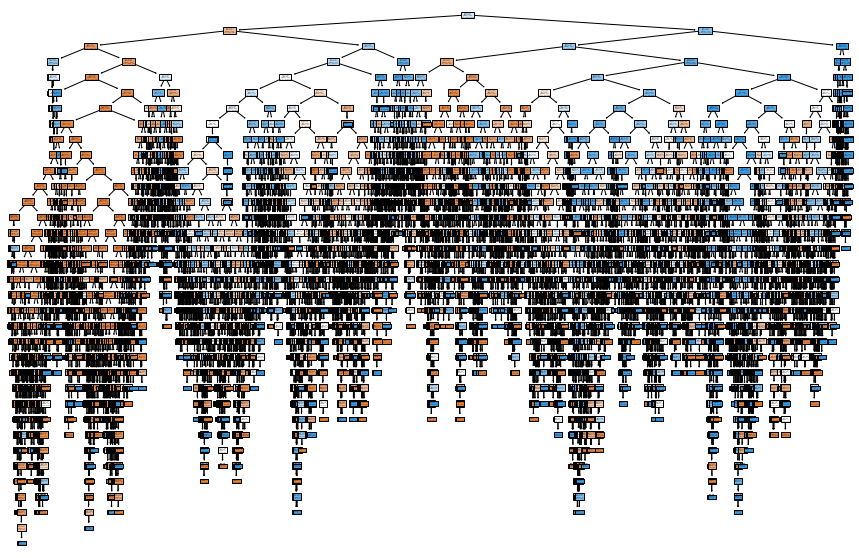

In [50]:
# Plotting RandomForest Tree
from sklearn import tree
plt.figure(figsize =(15,10))
for i in range(len(clf.estimators_)):
    tree.plot_tree(clf.estimators_[i],filled = True)

In [52]:
print(tree.export_text(clf))

AttributeError: 'RandomForestClassifier' object has no attribute 'tree_'

### Model Evaluation & Validation(teqniques):  

##### Validation: Cross validate

In [27]:
from sklearn.model_selection import cross_val_score ,cross_validate

CV=cross_validate(RandomForestClassifier(),Input,Result,cv = 10 , return_train_score =True)
#print(CV["test_score"].mean().plot(kint = "hist"))
#print(CV["train_score"].mean())
CV

{'fit_time': array([12.63881874, 12.96652675, 16.62433338, 13.96865606, 13.07351327,
        14.32362819, 19.89462423, 14.96816635, 13.57204461, 11.96303082]),
 'score_time': array([0.37807846, 0.25227118, 0.38078237, 0.23786402, 0.31284404,
        0.29982972, 0.36173558, 0.27814078, 0.27656221, 0.22864485]),
 'test_score': array([0.89404189, 0.99388703, 0.69288451, 0.49869579, 0.88759374,
        0.97774698, 0.80167917, 0.96715031, 0.97954027, 0.76605804]),
 'train_score': array([0.99995472, 0.99995472, 0.99999094, 0.99999094, 0.99996377,
        0.99996377, 0.99997283, 0.99996377, 0.99996377, 0.99996377])}

###### Evaluation: Accuracy

In [28]:
# Import accuracy score. 
from sklearn.metrics import accuracy_score

# evaluating accuracy result for correct predicted data.
accuracy=accuracy_score(y_pred, y_test)

# print accuracy score result.
print('RandomForestClassifier Model accuracy score: {0:0.4f}'.format(accuracy_score(y_test, y_pred)))

RandomForestClassifier Model accuracy score: 0.9564


###### Evaluation: Classification report

In [29]:
# performance evaluation metric using classification report.

# Import packages and modules.
from sklearn.metrics import classification_report

# add classification report in shape of dataframe for easy reading.
Report = pd.DataFrame(classification_report(y_test,y_pred,output_dict = True)).transpose()

# show report results.
Report

,precision,recall,f1-score,support
0,0.945531,0.956192,0.950832,10820.000000
1,0.965134,0.956550,0.960823,13717.000000
accuracy,0.956392,0.956392,0.956392,0.956392
macro avg,0.955333,0.956371,0.955827,24537.000000
weighted avg,0.956490,0.956392,0.956417,24537.000000


###### Evaluation: Confusion matrix

,0,1
0,10346,474
1,596,13121


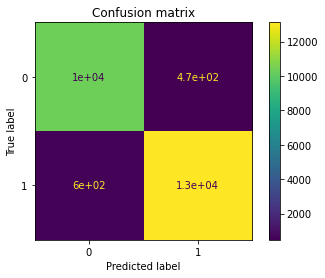

In [30]:
# performance evaluation metric using confusion matrix.

# Import packages and modules.
from sklearn.metrics import confusion_matrix,plot_confusion_matrix



# visualize Confusion matrix 
matrix = plot_confusion_matrix(clf,x_test,y_test)

# Confusion matrix title.
matrix.ax_.set_title("Confusion matrix", color = "Black")

# Confusion matrix result
pd.DataFrame(matrix.confusion_matrix)



# Savig Transfomer & Model

In [36]:
# Import module
import pickle
import bz2

# Save Module
pickle.dump(clf,bz2.BZ2File("model.pkl","wb"))

In [37]:
pickle.dump(le,bz2.BZ2File("Transformer.pkl","wb"))